# Assignment #4 - Reinforcement Learning


### Varsha Maurya

# I. Overview

* In this assignment we are trying to play Play jack with the dealer using Markov Decision Process.
* We will try to understand the process of Blackjack and then determine which MDP process is the best for black jack.
* we will try and understand different techiques in MDP.

# II. Problems 



## Blackjack

<img src="https://upload.wikimedia.org/wikipedia/commons/a/a2/Blackjack_game_1.JPG" width=800 />

Now, we play Blackjack! 
We have improved version of it from OpenAI Gym [Blackjack-V0](https://gym.openai.com/envs/Blackjack-v0/). Our blackjack has an additional betting option. Here follows the rule description. 


### <font color="red"> Game Introduction and Rules: </font>


Blackjack is a card game where the goal is to obtain cards that sum to as
near as possible to 21 without going over.  They're playing against a fixed
dealer.

Face cards (Jack, Queen, King) have point value 10.
Aces can either count as 11 or 1, and it's called 'usable' at 11.
This game is placed with an infinite deck (or with replacement).

The game starts with each player getting two face up cards and dealer
having one face up and face down card and the player needs to bet an 
amount of money within range of 1 to max bet (10). 
Note: Face up means that you will know what the card is.

The player can request additional cards (hit=1) until they decide to stop
(stick=0) or exceed 21 (bust).

After the player sticks, the dealer reveals their facedown card, and draws
until their sum is 17 or greater (fixed policy).  If the dealer goes bust the player wins.
You won't see the dealer's facedown card, just you will know if you have or lost
and you will get appropriate reward of +1 if you win, -1 if you loose or 0 if the match
is drawn.
(It is freedom of choice for you to change the reward function. If you want to change, you should explain the reason of the change.)

If the player wins, the amount he has bet will be doubled and given back. 
If the player and dealer have the same sum, then its a draw and the player will get
back the money he has bet. 
If the player loses then, the money he bet will be lost. 
If neither player nor dealer busts, the outcome (win, lose, draw) is
decided by whose sum is closer to 21. You are free to change the reward function to make it 
learn more efficiently. (i.e.,  the amount of money the user is winning after each round). 

Regardless of the number of players on the table, each player will be just playing against the 
dealer independently of the other players.

### HAVE MOVED ALL THE RUBRIC IN ONE PLACE BELOW THE TOY EXAMPLE

## BlackJack Environment

In [ ]:
import collections
import numpy as np
import matplotlib.pyplot as plt
import gym
from gym import spaces
from gym.utils import seeding
%matplotlib inline

### Player class definition

Player class defines an object for each BlackJack player with a given *unique* name. It has three attributes, the player's name, current cards in hand, and total balance left to play games.  <code>get_info()</code> is getter method that prints out all three attributes.

In [13]:
class Player():
    """
        
        Player class to create a player object.
        eg: player = Player("player1", start_balance = 10)
        Above declaration will be for your agent.
        All the player names should be unique or else you will get error.
        
    """
    def __init__(self, player_name, start_balance = 10):
        self.player_name = player_name
        self.card = []
        self.starter_balance = start_balance
        self.total_balance = start_balance

    def recharge_account(self):
        self.total_balance = self.starter_balance
        
    def get_info(self):
        print("Player name: {}".format(self.player_name))
        print("Player card: {}".format(self.card))
        print("Player total_balance: {}".format(self.total_balance))     

Following functions are utilities and definition of card deck to play games and to check the game status. 

In [14]:
# 1 = Ace, 2-10 = Number cards, Jack/Queen/King = 10
deck = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 10, 10, 10]

def cmp(a, b):
    return float(a > b) - float(a < b)

def draw_card(np_random):
    return int(np_random.choice(deck))

def draw_hand(np_random):
    return [draw_card(np_random), draw_card(np_random)]


def usable_ace(hand):  # Does this hand have a usable ace?
    return 1 in hand and sum(hand) + 10 <= 21


def sum_hand(hand):  # Return current hand total
    if usable_ace(hand):
        return sum(hand) + 10
    return sum(hand)


def is_bust(hand):  # Is this hand a bust?
    return sum_hand(hand) > 21


def score(hand):  # What is the score of this hand (0 if bust)
    return 0 if is_bust(hand) else sum_hand(hand)


def is_natural(hand):  # Is this hand a natural blackjack?
    return sorted(hand) == [1, 10]

### Game Environment

The Blackjack game environment is defined as follows. Inheriting, OpenAI.Gym.Env, it overrides the interfances to enable the interfaction with the same interfaces with other OpenAI Gym environments. 

These are important member functions to be used by you:
1. add_player: You can add your player object with some initial amount of money

2. step: you need to send the action using this function, actions are hit(1) or stand(0)
        returns {'state': player info and dealer info (_get_obs), 
                 'reward': real-valued reward, 
                 'is_round_done': True/Fasle}
3. _get_obs: returns the state of the env or required information you can use to build your agent. 
             eg: {'player_info':{'player_sum_card': sum of cards, 
                                 'player_card': list of cards, 
                                 'player_total_balance': real-valued number, 
                                 'usable_ace' : True/False}, 
                 'dealer_info': dealer's first card}
4. init_round: will start a new round in the same game.
        returns {'state': player info and dealer info (_get_obs)}
          
5. reset: will reset the whole game and you will being again with the initial balance you had started the player object.
        returns nothing, will just reset the entire game.
          
6. bet_money: you can bet the amount using this method, takes in the money between (1, max_bet_cap). max_bet_cap is 10. 
        returns nothing.


In [15]:


class BlackjackEnv(gym.Env):
    """
    Simple blackjack environment
    
    Blackjack is a card game where the goal is to obtain cards that sum to as
    near as possible to 21 without going over.  They're playing against a fixed
    dealer.
    Face cards (Jack, Queen, King) have point value 10.
    Aces can either count as 11 or 1, and it's called 'usable' at 11.
    This game is placed with an infinite deck (or with replacement).
    The game starts with each (player and dealer) having one face up and one
    face down card.
    The player can request additional cards (hit=1) until they decide to stop
    (stick=0) or exceed 21 (bust).
    After the player sticks, the dealer reveals their facedown card, and draws
    until their sum is 17 or greater.  If the dealer goes bust the player wins.
    If neither player nor dealer busts, the outcome (win, lose, draw) is
    decided by whose sum is closer to 21.  The reward for winning is +1,
    drawing is 0, and losing is -1.
    The observation is: the players current sum, players current card, players balance left, 
    the dealer's one showing card (1-10 where 1 is ace),
    and whether or not the player holds a usable ace (0 or 1).
    
    Parameters
    ==========
    natural      boolean
                 option for 50% more reward on natural blackjack 
    
    """
    
    def __init__(self, natural=False):
        self.action_space = spaces.Discrete(2)
        self.observation_space = spaces.Tuple((
            spaces.Discrete(32),
            spaces.Discrete(11),
            spaces.Discrete(2)))
        self.seed()
        self.total_players = 1
        self.players = {}
        self.natural = natural
        self.dealer = []
        self.round_bet_info = {}
        self.max_bet_cap = 10

    def add_player(self, player_class):
        if player_class not in self.players and len(self.players) < self.total_players:
            self.players[player_class.player_name] = player_class
        else:
            raise Exception("Maximum number of player allowed: {}. You can increase the player count while initializing the environment".format(len(self.players)))

    def seed(self, seed=None):
        self.np_random, seed = seeding.np_random(seed)
        return [seed]

    def step(self, player_name, action):
        assert self.action_space.contains(action)
        if action:  # hit: add a card to players hand and return
            self.players[player_name].card.append(draw_card(self.np_random))
            if is_bust(self.players[player_name].card):
                done = True
                reward = -1
            else:
                done = False
                reward = 0
        else:  # stick: play out the dealers hand, and score
            done = True
            while sum_hand(self.dealer) < 17:
                self.dealer.append(draw_card(self.np_random))
            reward = cmp(score(self.players[player_name].card), score(self.dealer))
            if self.natural and is_natural(self.players[player_name].card) and reward == 1:
                reward = 1.5
        if done:
            self.settle_balance(int(reward), player_name)
        return {'state':self._get_obs(player_name), 'reward': reward, 'is_round_done': done}

    def _get_obs(self, player_name):
        return {'player_info':self.get_player_obs(player_name), 
                'dealer_info': self.dealer[0]}

    def get_player_obs(self, player_name):
        return {'player_sum_card':sum_hand(self.players[player_name].card), 
                'player_card':self.players[player_name].card, 
                'player_total_balance':self.players[player_name].total_balance, 
                'usable_ace' : usable_ace(self.players[player_name].card)}
    
    def get_valid_bet_amount(self, player_name):
        print("player name: {} money left: {}".format(player_name, self.players[player_name].total_balance))
        if self.players[player_name].total_balance < 1:
            return {'is_round_done': True, 'valid_bet_amount': -1}
        max_bet_upper_limit = self.players[player_name].total_balance
        if self.players[player_name].total_balance >= self.max_bet_cap:
            max_bet_upper_limit = self.max_bet_cap            
        return {'is_round_done': False, 'valid_bet_amount': list(range(1, max_bet_upper_limit+1))}
            
    def init_round(self, player_name):         
        self.dealer = draw_hand(self.np_random)
        self.players[player_name].card = draw_hand(self.np_random)
        return {'state': self._get_obs(player_name)}        

    def bet_money(self, player_name, bet_amount):
        self.players[player_name].total_balance -= bet_amount
        self.round_bet_info[player_name] = bet_amount
            
    def settle_balance(self, is_winner, player_name):
        if is_winner == 1:
            print("player winner")
            self.players[player_name].total_balance += (2 * self.round_bet_info[player_name])
        elif is_winner == 0:
            print("Draw match")
            self.players[player_name].total_balance += self.round_bet_info[player_name]
        else:
            print("player loser, wont get back the money, try next round")
    
    def reset(self, natural=False):
        for player_name, player_class in self.players.items():
            player_class.recharge_account()
        self.natural = natural
        self.dealer = []
        self.round_bet_info = {}


### Example Run with Random Players

This following code shows how to create an environment and players to play 10 games with 20 maximum rounds. This only includes random betting and random hit/stick decision making. 

In [9]:
env = BlackjackEnv()
player1 = Player('player1')
env.add_player(player1)
#Number of games
number_of_games = 10

#Number of rounds
number_of_rounds = 20

for _game in range(number_of_games):

    env.reset()
    print("-"* 50)
    print("Game Number: {}".format(_game + 1))
    print("-"* 50)
    for _round in range(number_of_rounds): 
        print("%"* 50)
        print("Game Number: {} Round Number: {}".format(_game+1, _round+1))
        print("%"* 50)
        
        #Check if you have enough money left in the account to bet, if not break and start a new game
        valid_bet_flag = env.get_valid_bet_amount(player1.player_name)
        if valid_bet_flag['is_round_done']:
            print("You are out of money ! Will go to next game !!")
            break
        bet_amount = valid_bet_flag['valid_bet_amount']
        
        #Get the observations i.e state and use it to decide how much you want to bet
        round_obs = env.init_round(player1.player_name)
        print("Initial state: {}".format(round_obs))  
        
        # If you have just $1 left in the bank, you have no choice but to bet that amount 
        # and hopefully leave it to the fate for your agent to win and continue playing or just
        # start a new game
        print('The bet amount is : {}'.format(bet_amount))
        if len(bet_amount) == 1 and bet_amount[0] == 1:
            print("You can only bet 1. So betting only 1.")
            random_bet = 1
        else:
            random_bet = np.random.choice(bet_amount)
        print("Random Init Bet: {}".format(random_bet))
        env.bet_money(player1.player_name, random_bet)
          
        
        # Look at the state and take actions, here the actions are selected randomly
        # you can use the agent to select the action
        random_action = np.random.randint(0, 2)
        print("Action taken: {}".format(random_action))

        #Use the selected action to actually take the action in env by calling step
        round_obs = env.step(player1.player_name, random_action)
        print("State after 1st action: {}".format(round_obs))

        #Check if the game is not over, if your action is stand then the game is over, else
        #the game continues in this loop until your action is stand
        while not round_obs['is_round_done']:
            #Select an random action and take the action
            random_action = np.random.randint(0, 2)
            print("Action taken: {}".format(random_action))
            round_obs = env.step(player1.player_name, random_action)
            print("State after nth action: {}".format(round_obs))

        #Round over, but the game will continue untill you have exhausted your initial money 
        print("Balance Left: {}".format(round_obs['state']['player_info']['player_total_balance']))
        print("Round over")
        print("-%-"*30)
        if (_round + 1) == (number_of_rounds):
            print("Max number of rounds played. If you see this message, you are the winner.")

--------------------------------------------------
Game Number: 1
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 4}}
The bet amount is : [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
Random Init Bet: 6
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 16, 'usable_ace': True}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 16
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%


# II Methods

## 	A. Review of the SARSA and Q-Learning

### SARSA (State-Action-Reward-State-Action)
SARSA is an On-Policy method, which means it computes the Q-value according to a certain policy and then the agent follows that policy.


**[Sarsa Pseudo-code]**
![](http://incompleteideas.net/book/ebook/pseudotmp8.png)

* In Sarsa we usually follow the current policy and assign the next state based on the action described in the policy.
* Since Sarsa the epsilon-greedy function is the difference between Q(s,a) and the weighted sum of the average action value viz nothing but the mean and the maximum.
* Sarsa will tend to converge if the system has a single convergence point

**[Update Equation for SARSA]**
$$
    Q(s_t, a_t) \leftarrow Q(s_t, a_t) + \alpha ( R_{t+1} + \gamma Q(s_{t+1}, a_{t+1}) - Q(s_t, a_t)) 
$$


**[Epsilon function]**
$$
    Q(s_t, a_t) \leftarrow {(1 - \alpha)_{mean(a)} Q(s_t, a_t)} + \alpha (current sample) 
$$


### Q-Learning 
Q-Learning is an Off-Policy method. It consists of computing the Q-value according to a greedy policy, but the agent does not necessarily follow the greedy policy.

**[Q-Learning Pseudo-code]**
![](http://incompleteideas.net/book/ebook/pseudotmp9.png)

* Q-Learning makes use off the notion of something called as epsilon greedy function which it uses to do exploration and exploitation based on the value of epsilon.
* In Q-Learning the the action's are chosen greedily i.e: For each state the function will choose the max of the action and will transition to the state corresponding to that action.
* Although Q-learning tells us to move in the direction of the maximum action it is important to remember that since we are using the e-greedy function during exploration phase $\epsilon$ will be considerably high and that brings in considerable amount of frandomness.

**[Update Equation for Q-Learning]**
$$
    Q(s_t, a_t) \leftarrow Q(s_t, a_t) + \alpha ( R_{t+1} + \gamma \max_a Q(s_{t+1}, a) - Q(s_t, a_t)) 
$$


**[Epsilon function]**


$$
    Q(s_t, a_t) \leftarrow {(1 - \alpha)  Q(s_t, a_t)} + \alpha (current sample) 
$$

The current sample would be $$ R_{t+1} + \gamma \max_a Q(s_{t+1}, a) $$

## B. Choice of TD learning and Reason

* We will use **Q-learning** for blackjack.

* The approach will usually converge sooner and since we will be limiting the total states only have 380 states to worry about as we will be making changes to the original observation thus helping us deal with many possible episodes and fewer states.

* we will use the above equation with **value function approximation** which is direct mapping to help us get the desired result.

* Also since the epsilon greedy function here can be used to spend more time on exploration phase than exploitation phase we shall make use of that.

* Though we won't be converging to a near optimal policy but blackjack is a game of randomness anyways since the card of the dealers the first time will be different. So there is no way to have a fixed policy that will help us win always.

## C. Choice of Function Approximation and Reason

We will use the Value Function Approximation as it is best suited for games which are not infinite.
Since we are modyfying our states to have Q which will never exceed more than 380 states

**[Value Function Approximation]**
$$
    W \leftarrow W + \alpha ( R + \gamma \max_a' Q(s', a') - Q(s, a)) ∇⃗_WQ(s,a)
$$


So we have the weights that are being updated based on the Q value. where $$ ∇⃗_WQ(s,a) $$ is nothing but mapping of input which will be $$ F(s,a) $$.

In this case that mapping can be linear as we map it on a one to one basis.

## D. Implementation of the selected approach (RLAgent)

In [131]:
class RLAgent():
    """
    Implementing Reinforcement learning using Q-learning.
    """
    
    def __init__(self, **kwargs):
        """
        Initialize all the required parameters that are necessary for the RL-Agent.
        """
        self.env = kwargs.get('env')
        self.valid_actions = list(range(self.env.action_space.n))
        self.epsilon = kwargs.get('epsilon')   # Random exploration factor.
        self.alpha = kwargs.get('alpha')       # Learning factor.
        self.gamma = kwargs.get('gamma')       # Discount factor- closer to 1 learns well into distant future.     
        self.Q = {}                            # Create dictionary of state-action pair each state will have corresponding actions.
        self.previous_bet = 1                  # Used to keep a track of the previous bet that was placed for the next bet.
          
    def is_state_present(self, state):
        """
        Set intial Q values for all the actions to 0.0 if observation not already in Q table
        """
        if state not in self.Q:
            self.Q[state] = dict((action, 0.0) for action in self.valid_actions)
            
    # Max action for the particular state.
    def greedy(self, state):
        """
        Pick the argmax action associated w.r.t to the Q-state.
        """
        self.is_state_present(state)
        return np.argmax(self.Q[state])  # greedy action selection

    # defining epsilon-greedy function.
    def e_greedy(self, state): 
        """
        Implementing the epsilion-greedy function.
        If the epsilon is greater than the randomness we are in the exploration phase
        If the epsilon is less than the randomness we are in the exploitation phase
        We generally want to have a decaying epsilon so that we can explore as much 
        as possible. Once we have done exploring we start exploting the policy.
        """
        self.is_state_present(state)
        if np.random.rand() < self.epsilon:
            return np.random.randint(self.env.action_space.n)
        else:
            return self.greedy(state)
    
    
    def epsilon_decay(self,episode,max_episodes):
        """
        Call the epsilon decay function so that we can control the exploration - exploitation.
        Once the epsilon is low the MDP should start expoiting. If everything else is implemented
        correctly we should see the player to start to win more often than not.
        Reduce from 0.8 to 0.5 to 0.2 to 0.0
        """
        #print('############################### inside here {}'.format(self.epsilon))
        if episode / max_episodes >= 0.25 and episode / max_episodes < 0.40:
            self.epsilon = 0.8
        elif episode / max_episodes >= 0.40 and episode / max_episodes < 0.60:
            self.epsilon = 0.5
        elif episode / max_episodes >= 0.60 and episode / max_episodes <= 1:
            self.epsilon = 0.2
        else:
            self.epsilon = 1
        
        
    #{'state':self._get_obs(player_name), 'reward': reward, 'is_round_done': done}
    def Q_learning(self, next_state, current_state,action, reward):
        """
        Called after the agent completes an action and receives an award.
        This function does not consider future rewards
        when conducting learning.
        """        
        self.Q[current_state][action] += self.alpha * (reward
                                                     + (self.gamma * self.greedy(next_state))
                                                     - self.Q[current_state][action])
        
    
    def set_the_bet(self, player,previous_round, available_amount):
        # Implementing the Oscar's system for betting.
        # Decide what you want to bet and go ahead and bet that amount.
        valid_bet_flag = self.env.get_valid_bet_amount(player)
        if valid_bet_flag['is_round_done']:
            #print("You are out of money ! Will go to next game !!")
            return False
        
        bet_amount = valid_bet_flag['valid_bet_amount']
        #bet_amount = list(range(1,available_amount+1))
        #print('Player won previous round? : {}'.format(previous_round))
        
        # You won the previous hand per Oscar's system you double the bet
        if previous_round:
            place_bet = 2 * self.previous_bet
        # You lost the previous hand per Oscar's system you bet the same amount.
        else:
            #If you have the money to bet like the previous round you do. else you go all in
            place_bet = self.previous_bet
            
        # Check if you have this much money
        #print('The pace bet value is {} : and the len of bet amount is {}'.format(place_bet, len(bet_amount)))
        if(len(bet_amount) >= place_bet):
            self.previous_bet = 1
        else:
            #Play safe and try your luck. This means you don't have money.
            place_bet = bet_amount[-1]
            self.previous_bet = place_bet
        #print('Placing bet of {}'.format(place_bet))
        self.env.bet_money(player, place_bet)
        return True
                    
    
    def train(self, max_episodes,max_rounds,player):
        # Set the player information here.        
        #Iterate to max episodes
        # One complete episode would be traversing all the states before hitting the termination state
        # In this case the termination state would be (winning/losing/draw)
        #cumulative rtrace .. this is calculating a cumulative sum after each episode
        crtrace = []
        previous_round_reward = 0
        # This is used to trace the rewards
        rtrace = []
        # This is used to trace the steps
        rounds = []
        eps = []
        for episode in range(max_episodes):
            # Resetting the environment for a new game.
            self.env.reset()          
            # Previous round flag 
            # This is used to indicate if the player won the previous round.
            # Since we are using the Oscar's system for betting we would need this.
            # We start a round by setting previous round as win = True.
            previous_round = True
            
            # This is the total hands that a player can play in a single game / episode.
            # Which means this will keep accuring money for the player or the player will run out of money 
            # before the end of max rounds. At the end of max round if the player still has money that
            # will be the exit condition for this episode. So ideally the termination condition for each round is
            # either playing losing all money or he having some money left with him.
            for _round in range(max_rounds):
                # The dealer shuffles the card and we start a fresh game or blackjack
                initial_observation = self.env.init_round(player)
            
                state = (initial_observation['state']['player_info']['player_sum_card'],
                                  initial_observation['state']['dealer_info'],
                                  initial_observation['state']['player_info']['usable_ace'])
                
                # Once the card is given to you need to set a bet
                # Check the current state and decide how much you want to bet.
                is_bet_set = self.set_the_bet(player,
                                              previous_round,
                                              initial_observation['state']['player_info']['player_total_balance'])
                if not is_bet_set:
                    break;     
                            
                # Check if the game is not over, if your action is stand then the game is over, else
                # the game continues in this loop until your action is stand
                # We keep playing the game till the is_round_done flag is set to True.
                # This is where the dealer keeps drawing card until you go bust or you win
                while True:
                    # Call epsilon greedy.
                    action = self.e_greedy(state)
                    #print('The action taken is {}'.format(action))
                    # Call the step function.
                    # Step function returns {'state':self._get_obs(player_name), 'reward': reward, 'is_round_done': done}
                    round_observation = self.env.step(player, action)
                    next_state = (round_observation['state']['player_info']['player_sum_card'],
                                  round_observation['state']['dealer_info'],
                                  round_observation['state']['player_info']['usable_ace'])
                    # Call the Q function.
                    self.Q_learning(next_state,
                                    state,
                                    action,
                                    round_observation['reward'])
                    
                    state = next_state
                    #epsilon decay function
                    self.epsilon_decay(episode, max_episodes)
                    
                    previous_round = True if round_observation['reward'] > 0 else False
                    
                    if round_observation['is_round_done']:
                        break
                if (_round + 1) == (max_rounds):
                    print("You won {} !!! You slayed the dealer".format(player))  
            
            eps.append(self.epsilon)
            rounds.append(_round + 1)
            rtrace.append(round_observation['state']['player_info']['player_total_balance'])
            previous_round_reward += round_observation['state']['player_info']['player_total_balance'] 
            crtrace.append(previous_round_reward)
            
        return rtrace,rounds,eps,crtrace
 

    def test(self,max_rounds,player):
        print('In here')
        print(len(self.Q))
        assert(len(self.Q) is not 0)
        print(self.epsilon)
        self.env.reset()
        previous_round = True
        for _round in range(max_rounds):
            initial_observation = self.env.init_round(player)
            state = (initial_observation['state']['player_info']['player_sum_card'],
                                  initial_observation['state']['dealer_info'],
                                  initial_observation['state']['player_info']['usable_ace'])
            
            is_bet_set = self.set_the_bet(player,
                                          previous_round,
                                          initial_observation['state']['player_info']['player_total_balance'])
            if not is_bet_set:
                break;
                
            while True:
                action = self.e_greedy(state)
                round_observation = self.env.step(player, action)
        
                previous_round = True if round_observation['reward'] > 0 else False
                if round_observation['is_round_done']:
                        break
        if (_round + 1) == (max_rounds):
            print("You won {} !!! You slayed the dealer".format(player))
        reward = round_observation['state']['player_info']['player_total_balance']
        return reward



## E. Explanation of the codes

```
RLAgent() {

	init {
		1. Initialize all hyperparameter like alpha,Gamma,epsilon,Q.

	}
    
	is_state_present(state) {
		1. We check that if that if the given state is already present in Q dict.
		2. If it is not present we go ahead and add the state.
	}

	greedy(state) {
		1. We check if the state is present by calling `is_state_present`
		2. return the maximum value of all the actions available for the current state.
		In this case we only have two actions (hit/stick)
	}

	e_greedy(state) {
		1. Implement the epsilon greedy function using the above equation mentioned

	}

	epsilon_decay(episode,max_episodes) {
		1. Implementing epsilon decay as a step
		We do this so that in the intial phase of training I wanted the model to do exploration
		using constant randomness something that was close to 1.0 
		As the training reached closer to the number off samples we reduce the epsilon to
		see the drastic difference in the rewards.
	}

	Q_learning(next_state, current_state,action, reward) {

		1. Implementing the Q-learning function as described above.
	}

	set_the_bet(player,previous_round, available_amount) {
		1. Using oscars mechanism to place bet. 
		2. Though oscars system doubles after every win we din't do that as the risk factor of 
		going bust was very high so we settled for the max bet of 10.
		3. We first check if there is enough money to set the bet and only then place the bet.
	}

	train(max_episodes,max_rounds,player) {
		1. Loop through the max_episodes
		2. reset the environment
		3. Loop through max rounds
		4. Have an initial observation by calling `env.init_round(player)`
		5. Gather the state from the observation
		6. set the bet.
		7. Play the round with the dealer
			i. 	Take an action greedily this calls the `e_greedy(state)` method.
			ii. get the observation by calling `step(player,action)` method.
			iii.get the next_state from the above observation
			iv. call the q-learning method.
			v.  update the state to to next_state.
			vi. call the epsilon decay function.
			vii.check if you won the previous round. You use this to place bets.
			viii.If you are through all rounds then you won.
		8. return rewards, rounds and eps at each iteration of episode.
	}

	test(max_rounds,player) {
        1. Play the round with the dealer
            i. Take an action greedily this calls the `e_greedy(state)` method.
            ii. check if you won the previous round. You use this to place bets.
            iii. If you are through all rounds then you won.
        2. return reward
	}
}
```

# III Results

* Describe the choice of your parameters for  𝛾 ,  𝛼 , and  𝜖 .
    * Run experiments to find good parameters
    * Show the experimental outputs to show the process of your selection
* Visualize the results and explain outputs (even from mine.)
    * Run the codes and tell me what you observe
    * Add more visualizations to enrich your explanation.

## A. Reports the selected parameters

#### 1. epsilon 
1. The epsilon is the measure that is used by epsilon greedy function to allow randomness to kick in.
2. The epsilon value is the control / lever for exploration and the exploitation that happens during Q-learning.

We use a waterfall epsilon so that means that we never actually touch epsilon value and actually control it from the code so that we explore it for a lot of time and eventual start exploiting it.

#### 2. gamma
 The gamma we chose is 0.3 . The gamms is the discount factor which indicates that as we move along collecting rewards what will be the significance of rewards that were collected previously.

#### 3. alpha

The alpha that is the learning rate is chosen to be 0.1. The learning rate is similar to the learning rate that we had for NN and LR.

Below is the implementation details of how we choose these parameters.

## B. Experimental outputs that show the choice of parameters. How do you choose them?

Note : Trying to have as little as print statements possible 

Ideally it will be good if i can decrease the learning rate as i move ahead in evaluating policies for each epsiode.

* gammas = [0.1,0.5,0.7,0.1,0.7]
* alphas = [0.7,0.5,0.3,0.3,0.7]



We try different values of alphas and gammas 

The alpha values that we will try are *`[0.1,0.5,0.7,0.1,0.7]`*

and 

The gamma values that we will try are *`[0.7,0.5,0.3,0.3,0.7]`*

In [65]:
env = BlackjackEnv()
player1 = Player('Varsha')
env.add_player(player1)

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 22
Draw match
player name: Varsha money left: 22
player winner
player name: Varsha money left: 32
player winner
player name: Varsha money left: 42
player loser, wont get back the money, try next round
player name: Varsha money left: 32
player loser, wont get back the money, try next round
player name: Varsha money left: 22
player loser, wont get back the money, try next round
player

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
Draw match
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
Draw match
player name: Varsha money left: 20
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
p

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try ne

player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player na

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
Draw match
player name: Varsha money left: 30
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get

player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsh

player name: Varsha money left: 30
Draw match
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
Draw match
player name: Varsha money left: 40
player winner
player name: Varsha money left: 50
player loser, wont get back the money, try next round
player name: Varsha money left: 40
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont 

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
play

player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next rou

player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back th

player winner
player name: Varsha money left: 60
player loser, wont get back the money, try next round
player name: Varsha money left: 50
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get 

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha 

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha 

player name: Varsha money left: 30
Draw match
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player loser, wont get back the money, try next round
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player

player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
Draw match
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser

Draw match
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name:

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player loser, wont get back the money, try next round
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player loser, wont get back the money, try next round
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round


player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player loser, wont get back the money, try next round
player name: Varsha money left: 30
player l

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
Draw match
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Var

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha mone

player winner
player name: Varsha money left: 50
player winner
player name: Varsha money left: 60
player loser, wont get back the money, try next round
player name: Varsha money left: 50
player loser, wont get back the money, try next round
player name: Varsha money left: 40
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player loser, wont get back the money, try next round
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
pl

player winner
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player loser, wont get back the money, try next round
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player loser, wont get back the money, try next round
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30

player name: Varsha money left: 40
player loser, wont get back the money, try next round
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player loser, wont get back the money, try next round
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 2

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player winner
player name: Varsha money left: 50
player winner
player name: Varsha money left: 60
player loser, wont get back the money, try next round
player name: Varsha money left: 50
player loser, wont get back the money, try next round
player name: Varsha money left: 40
player loser, wont get back the mon

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha 

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player winner
player name: Varsha money left: 50
player loser, wont get back the

player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, w

player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try ne

player winner
player name: Varsha money left: 40
player loser, wont get back the money, try next round
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player lo

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
Draw match
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player loser, wont get back the money, try next round
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 1

player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player loser, wont get back the money, try next round
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player loser, wont get back the money, try next round
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back t

player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player winner
playe

player name: Varsha money left: 50
player loser, wont get back the money, try next round
player name: Varsha money left: 40
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
p

player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 30
player winner
player name: Varsha money left: 40
player winner
player name: Varsha money left: 50
player loser, wont get back the money, try next round
player name: Varsha money left: 40
player winner
player name: Varsha money left: 50
player loser, wont get back the money, try next round
player name: Varsha money left: 40
Draw match
player name: Varsha money left: 40
player loser, wont get back the money, try next round
player name: Varsha money left: 30
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money

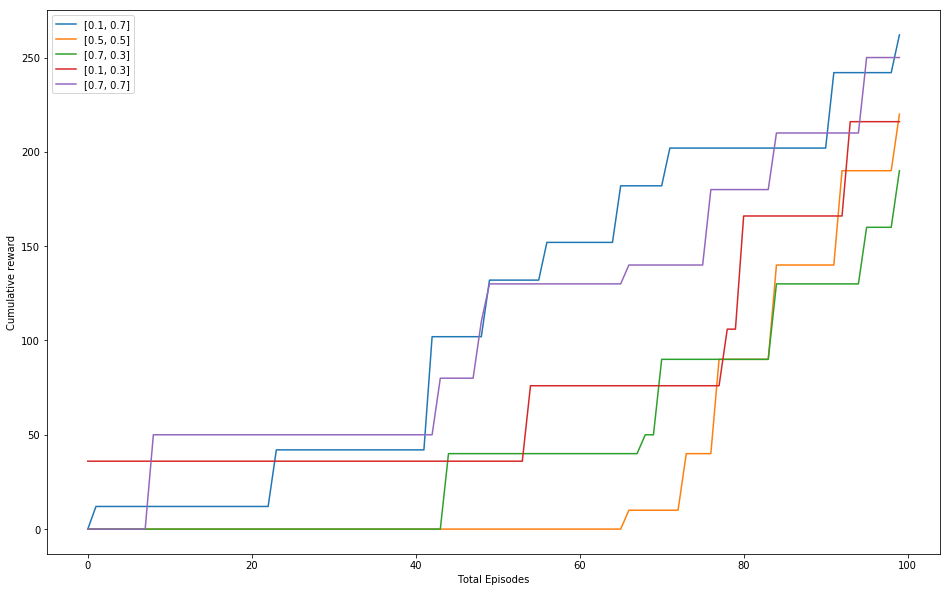

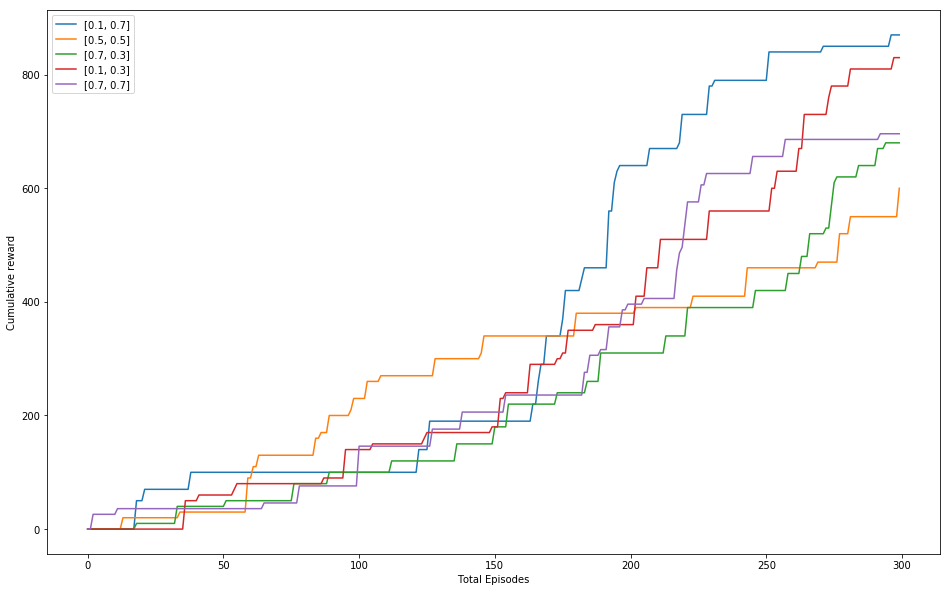

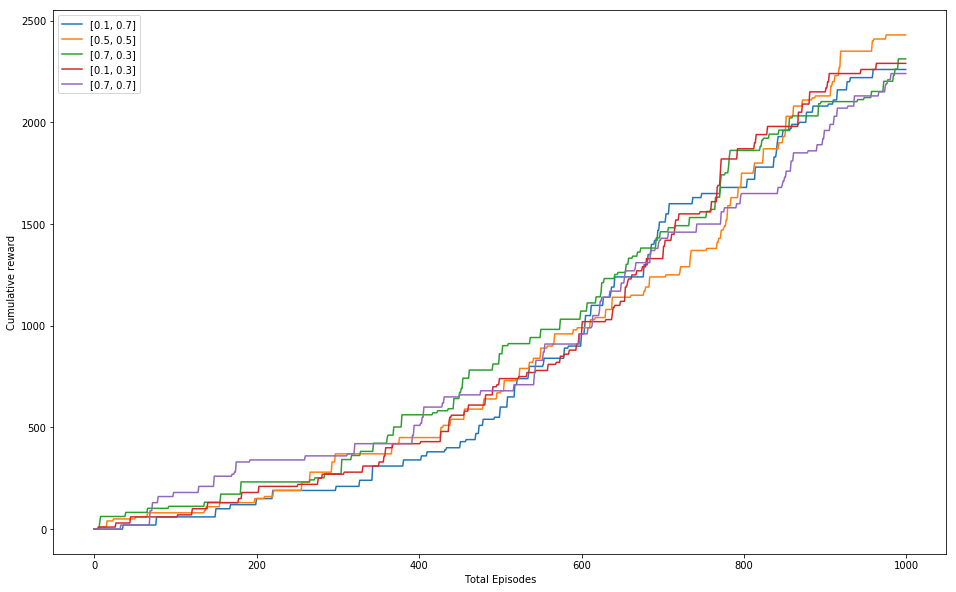

In [66]:

# Episodes that we want to try 
total_episodes = [100,300,1000]

#changing gamma and alphas
gammas = [0.1,0.5,0.7,0.1,0.7]
alphas = [0.7,0.5,0.3,0.3,0.7]

for i in range(3):
    X = []
    legend = []
    for j in range(5):
        legend.append([gammas[j],alphas[j]])
        rl = RLAgent(env=env, epsilon=1, gamma=gammas[j], alpha=alphas[j] )
        _,_,_,crtrace = rl.train(total_episodes[i],10,player1.player_name)
        X.append(crtrace)
    
    fig = plt.figure(figsize=(16,10))
    plt.xlabel('Total Episodes')
    plt.ylabel('Cumulative reward')
    
    for k in range(5):
        plt.plot(X[k])
    plt.legend(["{}".format(l) for l in legend], loc='upper left')


From the above experimentation based on cumulative rewards we can see that `alpha` = 0.1 and `gamma` = 0.3 
provides a good result though for our final experimentation most of them were close to convergence but that is something
we anticipate Q-learning to do to converge as we increase the total number of episodes.


#### Final training  ( RUN THIS BEFORE STARTING TOURNAMENT) (Also clear the ouput)

In [100]:
env = BlackjackEnv()
player1 = Player('Varsha')
env.add_player(player1)

In [132]:
RL = RLAgent(env=env, epsilon=1, gamma=0.3, alpha=0.1 )
rtrace,rounds,eps,crtrace = RL.train(20000,100,player1.player_name)

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next ro

player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont g

player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get b

player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
play

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Va

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
pla

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left:

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Var

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha mon

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha mon

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
p

player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha 

player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
pla

player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha mon

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
play

player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get

player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
p

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: V

player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha mon

player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back t

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Dra

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money lef

player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsh

player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: 

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
pl

player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back 

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player nam

player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money 

player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money 

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont g

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
play

player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player nam

player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Va

Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha mone

player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont ge

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try ne

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, t

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser

player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next rou

player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player loser, wont 

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the 

player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsh

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try 

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get

player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back

player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha 

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money 

player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
play

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha mon

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
Draw match
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser,

player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money,

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try

player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, w

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money lef

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: 

player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player w

player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money lef

player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
p

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player lo

player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
playe

player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wo

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha mon

player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the m

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
pl

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha mon

player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try 

player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, won

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, 

player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the 

player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player loser, wont get back the money,

player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player win

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money 

player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Va

player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money lef

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, t

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next ro

player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the mo

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player l

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Var

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha mone

player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Va

player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player na

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsh

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winn

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wo

player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the 

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get b

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back t

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try ne

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money lef

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Va

player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, t

player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the 

player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsh

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Va

player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back th

player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Va

player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player n

player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
Draw match
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
playe

player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the 

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha mon

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsh

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back t

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player los

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Va

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player winner
player name

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
pl

player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
pl

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money le

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back th

player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name:

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha m

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, tr

player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player 

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Va

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
You won Varsha !

player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont g

player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsh

player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
pla

player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player na

player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back t

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money,

player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money,

player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: 

player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsh

player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: 

player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money

player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money lef

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wo

player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try

Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the mon

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try 

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money l

player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: 

player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha mone

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha mone

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money lef

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the 

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsh

player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money 

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha mon

player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsh

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the mon

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha 

player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Va

player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
pla

player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsh

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round


player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money lef

player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try 

player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wo

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
pla

player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get bac

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha m

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
playe

player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
Draw match
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the mo

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player

player winner
player name: Varsha money left: 21
player loser, wont get back the money, try next round
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try nex

player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name:

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player lose

player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get b

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha 

player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player 

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the 

player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: V

player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
Draw match
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Vars

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the mon

player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player winner
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
Draw match
player name: Varsha money left: 17
player winner
player name: Varsha money left: 18
Draw match
player name: Varsha money left: 18
player winner
player name: Varsha money left: 19
player winner
player name: Varsha money left: 21
player winner
player n

player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player 

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Va

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next rou

player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player l

player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Var

Draw match
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
pla

player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round


player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next ro

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next 

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the mon

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money le

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha mone

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 

Draw match
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back th

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left

player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the 

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha

player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get b

player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
p

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, w

player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money lef

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back t

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player w

player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try n

player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Var

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player w

player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money lef

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha

player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get ba

player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
Draw match
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player lose

player winner
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money lef

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player

player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the

player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha m

player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player 

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
pl

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back 

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player 

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player n

player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner


player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back t

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha

player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left

player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next

player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Va

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha m

player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player winner
player name: Varsha money left: 21
Draw match
player name: Varsha money left: 21
player winner
player name: Varsha money left: 22
player winner
player name: Varsha money left: 24
player loser, wont get back the money, try next round
player name: Varsha money left: 22
player loser, wont get back the money, try next round
player name: Varsha money left: 21
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 21
player loser, wont get back the money, try next round
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player winner
player name: Varsha mon

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner


player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player 

player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsh

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Vars

player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left

player winner
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
Draw match
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get ba

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money,

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Va

player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back t

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsh

player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wo

player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Va

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha 

player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha mone

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha mo

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
pl

player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Vars

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back t

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
Draw match
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the

player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player lo

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back th

player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
playe

player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Va

player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, 

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser,

player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser,

player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: 

player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the mo

player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player l

player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player n

player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Vars

player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
pla

player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try

player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player 

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the mo

player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player 

player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try 

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player na

player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont ge

Draw match
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try nex

player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
Draw match
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player 

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: 

player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
Draw match
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player

player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try 

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
Draw m

player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next rou

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player lose

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money le

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try nex

player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wo

player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, 

player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money 

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser,

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try 

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha m

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money lef

player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player w

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back t

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player 

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Va

player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next ro

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try 

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left:

player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player n

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Va

player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money,

player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player winner
player name: Varsha money left: 19
Draw match
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player winner
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15


player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
pla

player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
play

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player

player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10


player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
p

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try 

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser,

player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 1

player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player nam

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
pl

player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try 

player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
pl

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, w

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, won

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha m

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5


player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont 

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money lef

player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha m

player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get ba

player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
Draw match
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, won

player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the mon

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the 

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont ge

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money l

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money l

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
playe

player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back t

player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
pla

player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try nex

player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Var

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7


player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player wi

player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back t

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money le

player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
playe

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, w

player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back t

player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha m

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get b

player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the 

player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: 

player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back th

player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get ba

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
pla

player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get 

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money lef

player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name:

player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player na

player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next rou

player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player w

player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player 

player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player winner
player name: V

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back t

player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
pl

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player l

You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont ge

player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, won

player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont ge

player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: V

player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha mone

player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next roun

player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
pla

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back t

player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Var

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Var

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money 

Draw match
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
Draw match
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money le

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont 

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner


player loser, wont get back the money, try next round
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
Draw match
player name: Varsha money left: 18
player winner
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player winner
player name: Varsha money left: 21
player loser, wont get back the money, try next round
player name: Varsha money left: 19
player winner
player n

player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winn

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money 

player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player

player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: V

player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
Dra

player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
p

player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
playe

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try nex

Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont ge

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsh

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
p

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont ge

player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the m

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the mon

player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont 

player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser,

player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money,

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
pl

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Va

player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 22
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 19
player loser, wont get back the money, 

player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
pl

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Var

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
pla

player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
Draw match
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back t

player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player

player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
Draw match
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
p

player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player l

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player 

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player

player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Var

player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Va

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name:

player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player na

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back t

player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
Draw match
player name: Varsha money left: 17
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left:

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player 

player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name:

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
Draw match
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, w

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
Draw match
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player los

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha mo

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player loser, wont get back the

player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner


player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont ge

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 

player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Va

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money

player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Vars

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
pla

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try 

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Va

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha mon

Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
Dra

player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player 

player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next 

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try n

player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player nam

player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round


player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player 

player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player 

player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
Draw match
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8


player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
Draw match
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next roun

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player 

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the 

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
playe

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
p

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
Draw match
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont

player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
play

player loser, wont get back the money, try next round
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Vars

player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back 

player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player nam

player winner
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, w

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money

player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money,

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money lef

player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
play

player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsh

player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, 

player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try 

player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 

player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get bac

player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Vars

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
p

player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money,

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next

player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha mo

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back

player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the 

player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
pl

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha

player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
p

player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name:

player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha mone

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round


player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player n

player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner


player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 22
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 19
player winner
player name: Varsha money left: 20
Draw match
player name: Va

player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
p

player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha m

player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha 

player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha mon

player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player lose

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money 

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Var

player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsh

player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Va

player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: V

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player na

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
Draw match
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
Draw match
pl

player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get 

player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha m

player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get ba

player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player winner
player name: Varsha money l

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
Draw match
player name: Varsha money left: 14
player winner
playe

player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money l

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha 

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player los

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back t

player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
pl

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha mone

player name: Varsha money left: 21
player loser, wont get back the money, try next round
player name: Varsha money left: 19
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player winner
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
Draw match
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player lose

player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha m

player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13


player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try nex

Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player

Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player nam

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Var

player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get b

player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, tr

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: V

player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money lef

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner


player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
pla

player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the mon

player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont g

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the mon

player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha mo

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the mon

player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get 

player loser, wont get back the money, try next round
player name: Varsha money left: 17
player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
Draw match
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 22
player winner
player name: Varsha money left: 24
player loser, wont get back 

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money le

player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player na

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
Draw match
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try

player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
Draw match
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back th

player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the mon

player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try n

player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont ge

player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
Draw match
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha mon

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the mon

player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try 

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsh

player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 

player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try ne

player name: Varsha money left: 21
player loser, wont get back the money, try next round
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
playe

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money l

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round


player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player wi

player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner

player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player n

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player n

player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next 

player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha mon

player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get ba

player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: 

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
pl

player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next 

player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money 

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
Draw match
player name: Varsha money left: 1

player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser,

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha mone

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money lef

player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left:

player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha mon

player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
play

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left:

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha mone

player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha 

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player 

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
Draw match
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the mone

player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Va

player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: V

player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
pl

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
pla

player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next ro

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player 

player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back th

player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next roun

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player 

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player 

player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
Draw match
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player winner
player name: Varsha money left: 21
player loser, wont get back the money, try next round
player name: Varsha money left: 19
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money le

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
pla

player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money l

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left:

player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player

player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
pla

player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player winner
player name: Varsha money left: 21
player loser, wont get back the money, try next round
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player winner
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 22
player winner
player n

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
Draw match
player name: Varsha money left: 17
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player nam

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, 

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player nam

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, won

player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player winner
pla

Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player n

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money l

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
p

player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
pla

player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9

player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11

player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsh

player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money l

player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Vars

player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Vars

player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, 

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, tr

player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha mon

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money 

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
playe

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get bac

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the 

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back t

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Vars

player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player 

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player n

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
player lo

player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try 

player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
Draw match
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player winner
player name: Varsha money left: 21
player winner
player name: Varsha money left: 23
player winner
player name: Varsha money left: 25
player loser, wont get back the money, try next round
player name: Varsha money left: 23
player loser, wont get back the money, try next round
player name: Varsha money left: 22
player winner
player name: Varsha money left: 23
player loser, wont get back the money, try next round
player name: Varsha money left: 21
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money le

Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
You won Varsha !!! You slayed the dealer

player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player winner
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
play

player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
pl

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: 

player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Va

player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner

player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get

player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player win

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money l

player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
p

player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
play

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Va

player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player l

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: V

player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
pla

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get 

player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser,

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
Draw match
player name: Varsha money l

Draw match
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: 

player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: 

player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
Draw match
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name

player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12


player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont ge

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the mon

player loser, wont get back the money, try next round
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont g

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player winner
pla

player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winne

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money

player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next 

player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the m

player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try 

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont 

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha mo

player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont ge

player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money l

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left

player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
Draw match
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money le

player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
Draw match
player name: Varsha money left: 19
Draw match
player name: Varsha money left: 19
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
playe

player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, 

player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
player winner
player name: Varsha money left: 22
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 21
player winner
player name: Varsha money left: 23
player winner
player name: Varsha money left: 25
p

player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha 

player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round


player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money

player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player n

player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wo

player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the m

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Var

player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
You won 

player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: V

Draw match
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wo

Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha m

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Var

player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money l

player name: Varsha money left: 4
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player lo

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money lef

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, t

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Va

player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha

player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Var

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money l

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player nam

player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Va

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: V

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player lose

player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
pla

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha mone

player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the mo

player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
You won Varsha !!! You slayed the dealer
play

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get bac

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Va

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsh

player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name:

player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player nam

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 

player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the 

player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next roun

player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next 

player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
You won Varsha !!! You

Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round

player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get

player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player lose

player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: 

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Var

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next r

player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money 

player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back 

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next rou

player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get 

player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player wi

player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player win

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get ba

player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsh

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
pla

player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next rou

player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, w

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, 

player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, 

player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
Draw match
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
Draw match
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try ne

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money lef

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha mo

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha mon

player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
pl

player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: 

player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player 

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha m

player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next r

player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player n

player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
pla

player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next 

player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha 

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back 

player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
You won Varsha !!! You slayed 

player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha

player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player l

player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player 

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha mo

player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
Draw match
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
player loser, wont get back the m

player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha mone

player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, w

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player w

player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
Draw match
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
Draw match
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
p

player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player winner
player name: Varsha money left: 19
player winner
player name: Varsha money left: 21
player winner
player name: Varsha money left: 23
player winner
player name: Varsha money left: 25
player loser, wo

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
p

player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, w

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha 

player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
pla

player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player l

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
playe

player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha mone

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha

player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player n

player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha

player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: V

player name: Varsha money left: 23
player loser, wont get back the money, try next round
player name: Varsha money left: 21
player winner
player name: Varsha money left: 22
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player winner
player name: Varsha money left: 21
player winner
player name: Varsha money left: 23
Draw match
player name: Varsha money left: 23
player loser, wont get back the money, try next round
player name: Varsha money left: 22
player loser, wont get back the money, try next round
player name: Varsha money left: 21
player winner
player name: Varsha money left: 22
player winner
player name: Varsha money left: 24
player loser, wont get back the money, try next round
player name: Varsha money left: 22
player loser, wont get back the money, try next round
player name: Varsha money left: 21
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next rou

player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 16
Draw match
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
Draw match
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
pla

player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get 

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Var

player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money le

player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: V

player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round


player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
pla

player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsh

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: V

player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try nex

player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha mone

player name: Varsha money left: 16
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player l

player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player

player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
pl

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name

player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
playe

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: 

player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: 

player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player winner
player name: Varsha money left: 17
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next

player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha mon

player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha mon

player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, 

player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha m

player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get ba

player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
play

player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get bac

player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha mone

player loser, wont get back the money, try next round
player name: Varsha money left: 17
Draw match
player name: Varsha money left: 17
player winner
player name: Varsha money left: 18
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player winner
player name: Varsha money left: 19
player winner
player name: Varsha money left: 21
player loser, wont get back the money, try next round
player name: Varsha money left: 19
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha mon

player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 

player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8

player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser,

player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha m

player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player lo

player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: V

player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
Draw match
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money 

player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, 

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back t

player name: Varsha money left: 27
player loser, wont get back the money, try next round
player name: Varsha money left: 26
player winner
player name: Varsha money left: 27
player loser, wont get back the money, try next round
player name: Varsha money left: 25
player loser, wont get back the money, try next round
player name: Varsha money left: 24
player loser, wont get back the money, try next round
player name: Varsha money left: 23
player loser, wont get back the money, try next round
player name: Varsha money left: 22
player winner
player name: Varsha money left: 23
player loser, wont get back the money, try next round
player name: Varsha money left: 21
player loser, wont get back the money, try next round
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 19
player loser, wont get back the money, try next round
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name:

player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name

player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
Draw match
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money,

player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha mo

player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
Draw match
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wo

player loser, wont get back the money, try next round
player name: Varsha money left: 19
player winner
player name: Varsha money left: 20
player loser, wont get back the money, try next round
player name: Varsha money left: 18
Draw match
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 17
player winner
player name: Varsha money left: 18
player loser, wont get back the money, try next round
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
Draw match
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
Draw match
player na

player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, tr

player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back 

player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
Draw match
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player

player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont 

player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont ge

player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player na

player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: 

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
Draw match
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money,

player name: Varsha money left: 15
player winner
player name: Varsha money left: 16
player loser, wont get back the money, try next round
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player n

player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont 

player winner
player name: Varsha money left: 3
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player 

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont

player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player winner
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player winner
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
Draw match
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha mone

player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
Draw match
player name: Varsha money left: 14
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try 

player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
Draw match
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money,

player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player winner
playe

player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
D

player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 5
player winner
player name: Varsha money left: 6
player loser, wont get back the money, try next round
player name: Varsha money left: 4
player loser, wont get back the money, try next round
player name: Varsha money left: 3
player loser, wont get back the money, try next round
player name: Varsha money left: 2
player loser, wont get back the money, try next round
player name: Varsha money left: 1
player winner
player name: Varsha money left: 2
player winner
player name: Varsha money left: 4
player winner
player 

player name: Varsha money left: 6
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
Draw match
player name: Varsha money left: 11
player winner
player name: Varsha money left: 12
player winner
player name: Varsha money left: 14
player loser, wont get back the money, try next round
player name: Varsha money left: 12
player winner
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money,

player name: Varsha money left: 1
player loser, wont get back the money, try next round
player name: Varsha money left: 0
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player winner
player name: Varsha money left: 13
player winner
player name: Varsha money left: 15
player loser, wont get back the money, try next round
player name: Varsha money left: 13
player loser, wont get back the money, try next round
player name: Varsha money left: 12
Draw match
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 11
player loser, wont ge

player name: Varsha money left: 4
player winner
player name: Varsha money left: 5
player loser, wont get back the money, try next round
player name: Varsha money left: 3
Draw match
You won Varsha !!! You slayed the dealer
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
Draw match
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player winner
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player loser, won

In [140]:

reward = RL.test(50, player1.player_name)

In here
380
0.2
player name: Varsha money left: 10
player winner
player name: Varsha money left: 12
player loser, wont get back the money, try next round
player name: Varsha money left: 10
player winner
player name: Varsha money left: 11
player loser, wont get back the money, try next round
player name: Varsha money left: 9
Draw match
player name: Varsha money left: 9
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player winner
player name: Varsha money left: 8
player winner
player name: Varsha money left: 10
player loser, wont get back the money, try next round
player name: Varsha money left: 8
player loser, wont get back the money, try next round
player name: Varsha money left: 7
player loser, wont get back the money, try next round
player name: Varsha money left: 6
player winner
player name: Varsha money left: 7
player winner
player name: Varsha money left

## C. Output plots 

Text(0.5, 0, '# of episodes')

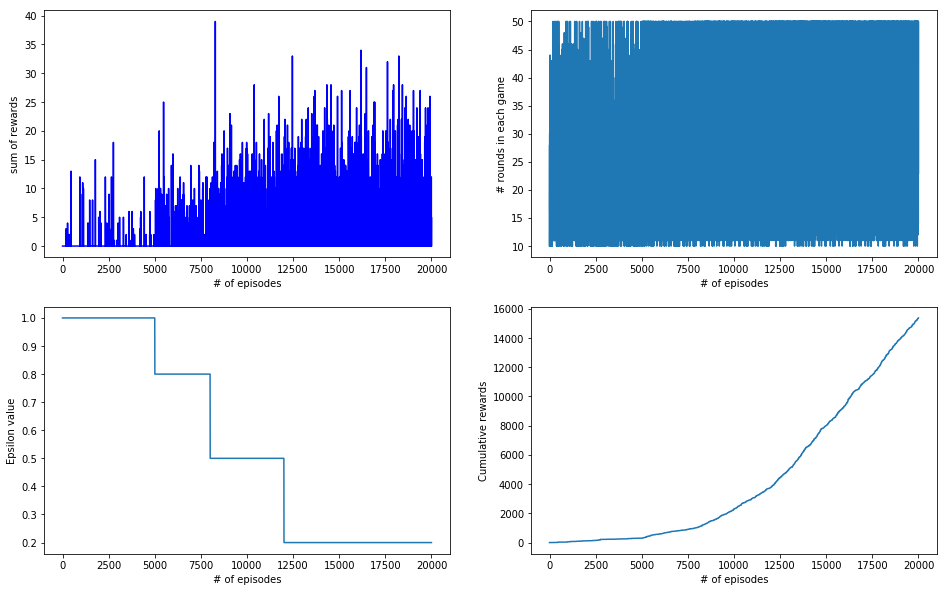

In [133]:
fig = plt.figure(figsize=(16,10))
fig.add_subplot(221)
plt.plot(rtrace, "b-")
plt.ylabel("sum of rewards")
plt.xlabel("# of episodes")

fig.add_subplot(222)
plt.plot(rounds)
plt.ylabel("# rounds in each game")
plt.xlabel("# of episodes")

fig.add_subplot(223)
plt.plot(eps)
plt.ylabel("Epsilon value")
plt.xlabel("# of episodes")

fig.add_subplot(224)
plt.plot(crtrace)
plt.ylabel("Cumulative rewards")
plt.xlabel("# of episodes")

## D. Reading and Analysis of learning results and plots 

We can clearly see from the above graphs that after we train our Q-learning for a considerable amount of time the probability of winning increases considerably and the cummulative rewards also starts increasing exponentially.

Below are some of values that are useful in understanding what our algortihm learned.

1. We have the Q-values and we can see that there is a considerable amount of chance of winning if there is a usuable ACE.

2. Also we see the average round for the player increases considerably in the end.

3. We can see that the rewards are more significant in the later half where we start exploiting.


#### Total number of rewards in the exploitation phase

In [55]:
np.count_nonzero(np.array(rounds[19000:]) == 50)

17

#### Q values that were learnt

In [105]:
rl.Q

{(20, 10, False): {0: 0.6049495215224743, 1: -0.998535156249968},
 (19, 10, False): {0: 0.5915016615557174, 1: -0.9843749999998845},
 (12, 2, True): {0: -0.43456125259399414, 1: 0.0},
 (12, 10, True): {0: 0.03149685358319254, 1: 0.0},
 (12, 10, False): {0: -0.8903034925453912, 1: -0.09375405351159216},
 (18, 9, False): {0: 0.030232076559877807, 1: -0.7918624877483963},
 (14, 5, False): {0: -0.05560296569056655, 1: -0.370962456633791},
 (13, 4, False): {0: 0.02964834361593216, 1: -0.2779084071712943},
 (16, 10, False): {0: -0.4993876216303751, 1: -0.8707570877529466},
 (15, 10, False): {0: -0.98998880385352, 1: -0.3961908234317665},
 (11, 10, False): {0: 0.0002442616070084114, 1: 0.0},
 (20, 2, False): {0: 0.8747482218094811, 1: -0.994140617549391},
 (9, 5, False): {0: 0.35012294375455244, 1: 0.0},
 (21, 8, True): {0: 0.998046875, 1: 0.0},
 (13, 9, True): {0: 0.008300825953483582, 1: 0.0},
 (7, 10, False): {0: -0.4906451695873314, 1: 0.0},
 (15, 2, True): {0: -0.9839974305596115, 1: 0.0

# IV. Participation

#### Please run the code in the B Block in III. before starting the tournament

In [ ]:
#RL.train(20000,50,player1.player_name)

reward = RL.test(50, player1.player_name)
reward

# V. Conclusions

1. The assignment was really a very interesting assignment and really had to put a lot of effort in understanding all the concepts regarding MDP before actually going and implementing it.

2. Some of the challenges that I faced was that i had to understand blackjack a little better had to spend time understanding some betting strategies.

3. Had to understand the concept of exploration and exploitation.